# Exploratory Data Analysis of Melbourne Housing Prices from 2016 to 2018
## By Timothy Hartanto (A1815246)

# Section 1 - Introduction

## 1.1 Background
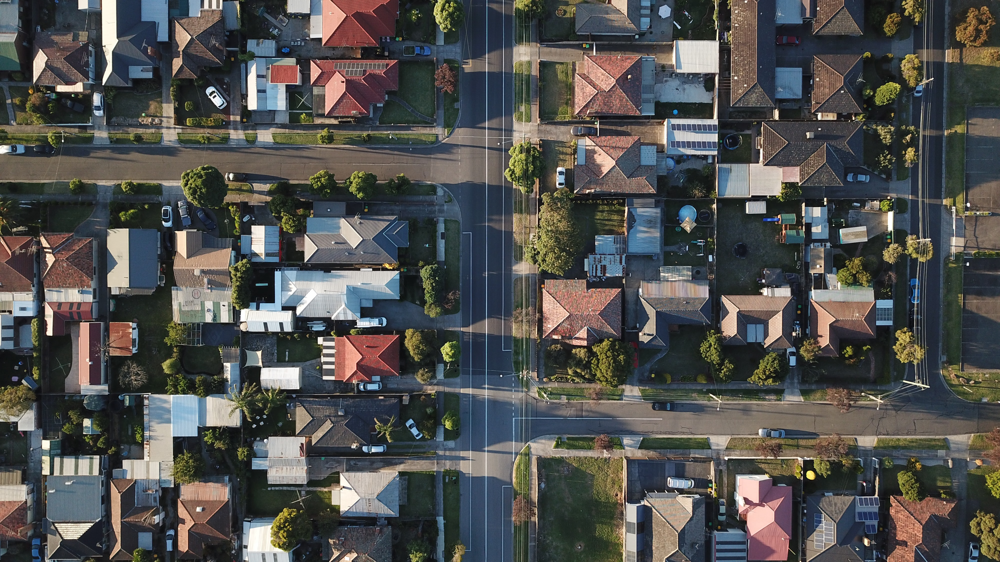

In January 2017, SQM Research founder Louis Christopher predicted that the Melbourne housing market would experience a boom that would last up until 2018 (Schlesinger 2017). Mr Christopther also stated that both Sydney and Melbourne's housing markets would be "dangerously overheated and overvalued" by the end of 2017, paving the way for a possible correction.

By the end of 2018, his forecast came to reality. The Melbourne housing market had indeed dramatically dropped by 7% in a year, with the fourth quarter of 2018 exhibitting the largest decline of the year at 3.2% (Zhou 2018). The downturn was severe enough that Torsten Slok, Deutsche Bank’s chief international economist, listed the Australian housing market as one of the top 30 economic risks to look out for in 2019.

With such backdrop, any data scientist would be intrigued to explore dataset detailing eventful house pricing movement during that timeframe. As it stands, one such public dataset exists from the [Kaggle website](https://www.kaggle.com/anthonypino/melbourne-housing-market) (Pino 2018) which will be the focus of this notebook.

## 1.2 Dataset Details

This dataset is culled from [kaggle](https://www.kaggle.com/anthonypino/melbourne-housing-market) (Pino 2018) and contains housing clearance data from 2016 to 2018. It includes 63,024 rows and 13 columns (as per the `MELBOURNE_HOUSE_PRICES_LESS.CSV` file), all of which will be described below:

|   Attribute   |                       Description                       |   Type   |
|:-------------:|:-------------------------------------------------------:|:--------:|
|     Suburb    |               Suburb of the sold property               |  String  |
|    Address    |               Address of the sold property              |  String  |
|     Rooms     |         Number of the rooms of the sold property        |  Integer |
|      Type     |         The type of housing of the sold property        |  String  |
|     Price     |              The price of the sold property             |   Float  |
|     Method    |                How the property was sold                |  String  |
|    SellerG    | The Real Estate Agent responsible for the sold property |  String  |
|      Date     |           The date when the property was sold           | datetime |
|    Postcode   |            The postcode of the sold property            |  Integer |
|   Regionname  |          The region where the property was sold         |  String  |
| Propertycount |      Number of properties that exist in the suburb      |  Integer |
|    Distance   |        Distance from Melbourne CBD in Kilometres        |   Float  |
|  CouncilArea  |   Governing council for the area of the sold property   |  String  |

Attributes `Type` and `Method` use the following codes within their cells:

- For `Method` column:

| Acronym |                 Meaning                |
|:-------:|:--------------------------------------:|
|    S    |              property sold             |
|    SP   |           property sold prior          |
|    PI   |           property passed in           |
|    PN   |        sold prior not disclosed        |
|    SN   |           sold not disclosed           |
|    NB   |                 no bid                 |
|    VB   |               vendor bid               |
|    W    |       withdrawn prior to auction       |
|    SA   |           sold after auction           |
|    SS   | sold after auction price not disclosed |
|   N/A   |   price or highest bid not available   |

- For `Type` column:

|  Acronym |                Meaning               |
|:--------:|:------------------------------------:|
|    br    |              bedroom(s)              |
|     h    | house, cottage, semi, villa, terrace |
|     u    |             unit, duplex             |
|     t    |               townhouse              |
| dev site |           development site           |
|   o res  |           other residential          |

## 1.3 Packages and Libraries Utilized
This notebook will also utilize several packages that will aid in exploratory data analysis (EDA) conducted upon the dataset, namely: `Numpy`, `Pandas`, `Matplotlib`, `Seaborn`, and `Datetime`. Additionally, `spearmanr` module from `scipy.stats` library will be loaded to conduct correlation analysis in Section 3.3

In [1]:
#importing all of the necessary libraries for this Exploratory Data Analysis 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
from scipy.stats import spearmanr
%matplotlib inline

We will also import `Plotly` library to enhance visualization for a time series plot.

In [2]:
import plotly as py
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

## 1.4 Purpose of Exploratory Data Analysis on Melbourne Housing Price Dataset

Generally, a data scientist conducts an exploratory data analysis to better understand dataset through the use of visualization that will reveal meaningful patterns and insights (Katari 2020). Furthermore, it also involves preparations of a dataset for analysis by removing irregularities in the data. As such, this notebook shall conduct:
- Data Wrangling & Cleaning
- Univariate analysis
- Bivariate analysis
- Time Series  analysis
- Regression/Correlation analysis

By conducting the activities above, one can reveal patterns and insight that will enable other stakeholders to process the data even further to influence business decisions in the future.

# Section 2 - Data Wrangling & Cleaning

In this section, the dataset will be loaded into Jupyter Notebook and processed for use in visualization later down the line. <br>This section is crucial to ensure the smoothness of the upcoming visualization process.

## 2.1 Data Import
To begin the EDA, the dataset must be loaded into the Jupyter Notebook environment. Date-related column is imported as datetime object using `parse_dates` argument.

In [3]:
# loading the dataset into Python
melb_df = pd.read_csv('MELBOURNE_HOUSE_PRICES_LESS.csv', parse_dates = ['Date'], low_memory = False)
melb_df.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Postcode,Regionname,Propertycount,Distance,CouncilArea
0,Abbotsford,49 Lithgow St,3,h,1490000.0,S,Jellis,2017-01-04,3067,Northern Metropolitan,4019,3.0,Yarra City Council
1,Abbotsford,59A Turner St,3,h,1220000.0,S,Marshall,2017-01-04,3067,Northern Metropolitan,4019,3.0,Yarra City Council
2,Abbotsford,119B Yarra St,3,h,1420000.0,S,Nelson,2017-01-04,3067,Northern Metropolitan,4019,3.0,Yarra City Council
3,Aberfeldie,68 Vida St,3,h,1515000.0,S,Barry,2017-01-04,3040,Western Metropolitan,1543,7.5,Moonee Valley City Council
4,Airport West,92 Clydesdale Rd,2,h,670000.0,S,Nelson,2017-01-04,3042,Western Metropolitan,3464,10.4,Moonee Valley City Council


In [4]:
# gathering the properties of each columns of the dataset
melb_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63023 entries, 0 to 63022
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Suburb         63023 non-null  object        
 1   Address        63023 non-null  object        
 2   Rooms          63023 non-null  int64         
 3   Type           63023 non-null  object        
 4   Price          48433 non-null  float64       
 5   Method         63023 non-null  object        
 6   SellerG        63023 non-null  object        
 7   Date           63023 non-null  datetime64[ns]
 8   Postcode       63023 non-null  int64         
 9   Regionname     63023 non-null  object        
 10  Propertycount  63023 non-null  int64         
 11  Distance       63023 non-null  float64       
 12  CouncilArea    63023 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(3), object(7)
memory usage: 6.3+ MB


## 2.2 Data Cleaning

Dataset usually has missing values due to improper entry. Those missing values should be identified and dealt with.

In [5]:
# checking for null values 
melb_df.isnull().sum()

Suburb               0
Address              0
Rooms                0
Type                 0
Price            14590
Method               0
SellerG              0
Date                 0
Postcode             0
Regionname           0
Propertycount        0
Distance             0
CouncilArea          0
dtype: int64

In [6]:
# filling in the null values
melb_df.Price.fillna(method = 'Pad', inplace = True)
melb_df.isnull().sum()

Suburb           0
Address          0
Rooms            0
Type             0
Price            0
Method           0
SellerG          0
Date             0
Postcode         0
Regionname       0
Propertycount    0
Distance         0
CouncilArea      0
dtype: int64

## 2.3 Data Wrangling

In this section, the dataset will be filtered and separated to prepare it for visualization later.

Firstly, two new columns will be created based on the date attribute of the dataset to prepare it for a data frame that will be used for the time series.

In [7]:
# creating a new column filled with year and month of the sell-off
melb_df['Year'] = pd.DatetimeIndex(melb_df['Date']).year
melb_df['Month'] = pd.DatetimeIndex(melb_df['Date']).month

After creating the Year and Month columns, the entire dataset will be filtered through those two properties using the `groupby` and `agg` function to determine the mean housing sale price from each month within each year. This new data frame, assigned to variable `ts`, will be used for creating a time series of the housing price from 2016 to 2018. Additionally, two new columns will be added to `ts` data frame containg the exponential moving averages with $\alpha$ of 0.1 and 0.3 respectively.

In [8]:
# Creating a new dataset based on grouping of Year and Month for timeseries
ts = melb_df.groupby(['Year','Month']).agg(avg_price=pd.NamedAgg(column="Price", aggfunc="mean"))
ts['EMA_0.1'] = ts.avg_price.ewm(alpha=0.1, adjust=False).mean() # creating an EMA column for visualization
ts['EMA_0.3'] = ts.avg_price.ewm(alpha=0.3, adjust=False).mean() # creating an EMA column for visualization
ts.reset_index(inplace = True) # reseting the multi index to a normal one
ts['Date'] = pd.to_datetime(ts.assign(Day=1).loc[:, ['Year','Month','Day']]) # a new column containing only month and year
ts

,Year,Month,avg_price,EMA_0.1,EMA_0.3,Date
0,2016,1,8.155882e+05,8.155882e+05,8.155882e+05,2016-01-01
1,2016,3,1.074449e+06,8.414743e+05,8.932465e+05,2016-03-01
2,2016,4,9.321948e+05,8.505464e+05,9.049310e+05,2016-04-01
3,2016,5,9.576674e+05,8.612585e+05,9.207519e+05,2016-05-01
4,2016,6,9.681272e+05,8.719454e+05,9.349645e+05,2016-06-01
5,2016,7,9.301567e+05,8.777665e+05,9.335222e+05,2016-07-01
6,2016,8,9.695507e+05,8.869449e+05,9.443307e+05,2016-08-01
7,2016,9,9.569687e+05,8.939473e+05,9.481221e+05,2016-09-01
8,2016,10,1.031332e+06,9.076858e+05,9.730851e+05,2016-10-01
9,2016,11,1.060243e+06,9.229415e+05,9.992326e+05,2016-11-01


The next part of data wrangling will filter out the numerical columns of the entire dataset before applying the `spearmanr` function to produce correlation figures amongst those columns for a correlation heatmap plot.

In [9]:
# filtering the dataset for numerical columns to be used for correlation
numerical_columns = [n for n,col in melb_df.items() if pd.api.types.is_numeric_dtype(col)]

# using spearmanr function to calculate the correlation amongst the numerical variables
corr = spearmanr(melb_df[numerical_columns].dropna()).correlation
corr

array([[ 1.00000000e+00,  3.46956115e-01,  6.92713377e-02,
        -3.99982894e-02,  3.28300562e-01,  1.66970753e-03,
         2.14225070e-03],
       [ 3.46956115e-01,  1.00000000e+00,  1.83198407e-01,
        -4.86132346e-02, -2.24486507e-01,  2.99004609e-02,
        -4.81645966e-03],
       [ 6.92713377e-02,  1.83198407e-01,  1.00000000e+00,
         3.58720006e-02,  3.39473380e-01, -1.72007391e-02,
        -5.14612674e-04],
       [-3.99982894e-02, -4.86132346e-02,  3.58720006e-02,
         1.00000000e+00, -2.32589975e-02,  9.60407848e-03,
         4.16200474e-03],
       [ 3.28300562e-01, -2.24486507e-01,  3.39473380e-01,
        -2.32589975e-02,  1.00000000e+00,  2.62667495e-02,
         1.07735645e-02],
       [ 1.66970753e-03,  2.99004609e-02, -1.72007391e-02,
         9.60407848e-03,  2.62667495e-02,  1.00000000e+00,
        -2.21445631e-01],
       [ 2.14225070e-03, -4.81645966e-03, -5.14612674e-04,
         4.16200474e-03,  1.07735645e-02, -2.21445631e-01,
         1.0000000

# Section 3 - Exploratory Data Analysis

## 3.1 Univariate Analysis
In this section, we shall visualize one column from the dataset to understand its distribution. The first plot comes from univariate analysis of Price column, arguably the target variable of this dataset.

Text(0.5, 1.0, 'Distribution of Prices of Sold Properties')

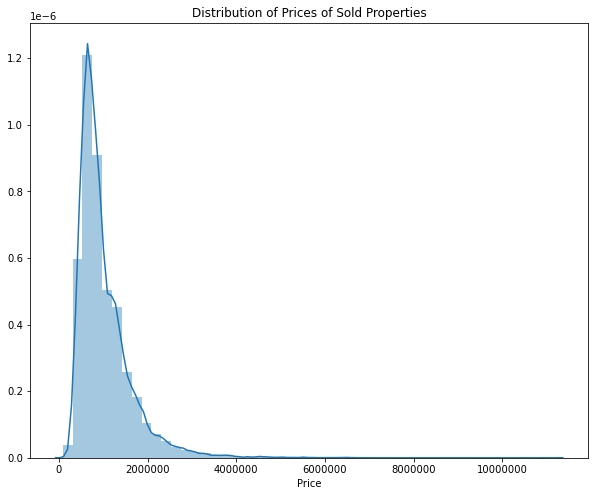

In [10]:
# creating a canvas for the plot
fig = plt.figure(figsize = [10,8])

# creating a distribution plot
sns.distplot(melb_df['Price'])

# modifying some properties of the plot
plt.ticklabel_format(style = 'Plain', axis = "x")
plt.title('Distribution of Prices of Sold Properties')

It's clear that the prices of sold properties in the dataset is heavily right-skewed thanks to a number of outliers to the right. This indicates that the following multivariate analysis can be biased due to those outliers.

The next plot will feature the distribution of numbers of rooms in properties sold.

Text(0.5, 1.0, 'Histogram of Number of Rooms of Sold Property')

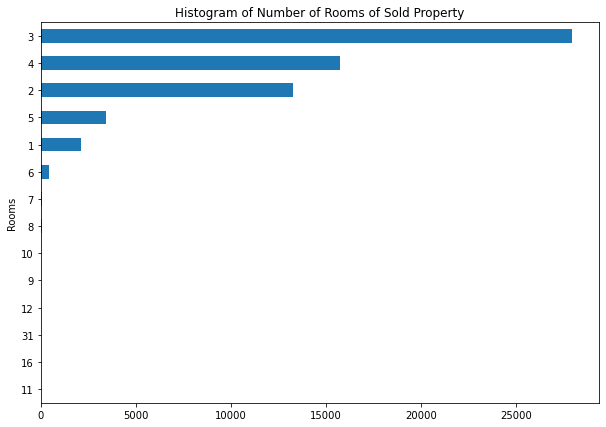

In [11]:
# creating the canvass
fig = plt.figure(figsize = [10,7])

# Filtering the dataset to count the number of rooms
rooms = melb_df.groupby("Rooms").count()['Price'].sort_values()

# creating the plot
rooms.plot.barh()

# Modifying some properties of the plot
plt.title('Histogram of Number of Rooms of Sold Property')

It appears that the majority of houses sold in during 2016 to 2018 had 3 to 4 rooms. 

Finally, to end this section, the dataset will be analyzed according to the way the properties were sold.

Text(0.5, 1.0, 'Pie chart of Different Selling Method')

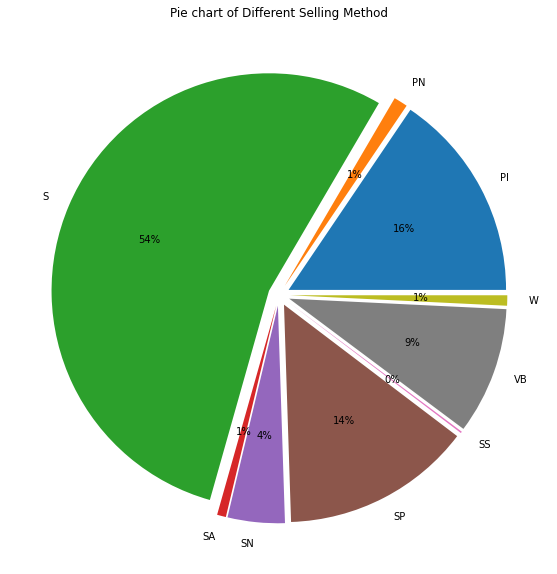

In [12]:
# Creating the canvass
fig = plt.figure()

# Filtering the dataset for the pie chart
method_pie = melb_df.groupby('Method').count()['Suburb']

# Creating the pie chart with the percentage figures
p = method_pie.plot.pie(explode = [0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05,0.05,],
                        autopct = '%1.0f%%', figsize = [10,10])

# Modifying some properties of the plot
plt.ylabel('')
plt.title('Pie chart of Different Selling Method')

A little more than half of the houses in the dataset were sold through an agent normally, with the rest of the properties being sold through differing methods in auction. Out of the myriad ways of auction sale, passed in property and sold prior to auction come in second and third behind the sold method, respectively. 

## 3.2 Bivariate Analysis

In this section two properties of the dataset will be combined to create a visualization that can be utilized to further enhance one's understanding of the shape of the dataset. 

The first plot will be a boxplot indicating the price range of sold properties grouped by the regions where they were located.

Text(0.5, 1.0, 'Boxplot of Price Grouped by Regions')

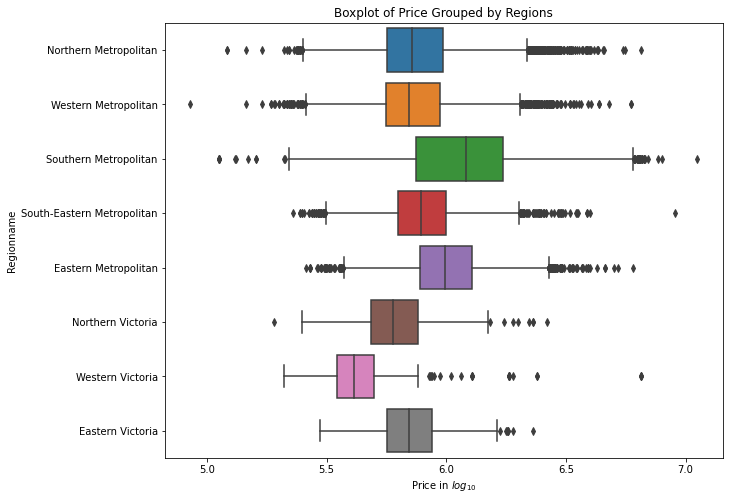

In [13]:
# creating the canvass
fig = plt.figure(figsize = [10,8])

# normalizing the distribution of the price range
data = np.log10(melb_df['Price'])

#creating the plot
sns.boxplot(data, 'Regionname', data = melb_df)

# Modifying the properties of the plot
plt.xlabel('Price in $log_{10}$')
plt.title('Boxplot of Price Grouped by Regions')

According to the boxplot, Souther Metropolitan Region had the most expensive price average, as well as the largest price range of properties sold across the 8 region. This implies that Southern Metropolitan Area saw the busiest property transactions during 2016 to 2018. 

The next plot features a boxenplot that will be used to determine the price distribution for the different types of houses sold.

Text(0.5, 1.0, 'BoxenPlot of Housing Types')

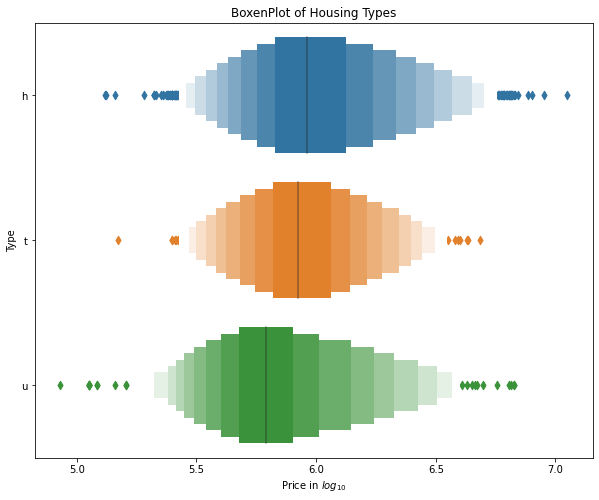

In [14]:
# Creating the canvass
fig = plt.figure(figsize = [10,8])

# normalizing the data
data = np.log10(melb_df['Price'])

# creating the boxenplot
sns.boxenplot(data, 'Type', data = melb_df, scale = 'linear')

# modifying the properties of the dataset
plt.xlabel('Price in $log_{10}$')
plt.title('BoxenPlot of Housing Types')

By examining the plot above, it's clear that houses have the edge in prices against townhouses and unit duplexes, which have cheaper price ranges than the other two types.

## 3.3 Time Series Analysis

A time series plot will reveal the price movement of Melbourne housing market from 2016 to 2018. Unfortunately, using a simple time series plot line alone will not suffice in revealing broader trends of the market as the dataset has too many outliers as demonstrated by the the price histogram plot. 

Thus, an exponential moving average (EMA) is added to filter out noise and identify trends (Moreno 2020). The algebraic formula of EMA is:
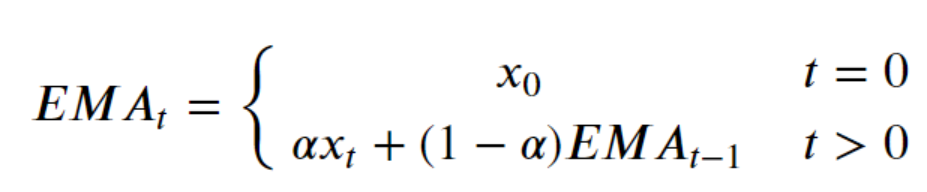
where:
- xₜ is the observation at the time period t.
- EMAₜ is the exponential moving average at the time period t.
- α is the smoothing factor, which has a value between 0 and 1 and represents the weighting applied to the most recent period.

This time series will utilize the plotly graphing library to heighten the interactivity of the graph for better analysis.

In [15]:
# importing the price data and EMA from the filtered dataset in variable ts into the plotly framework
avg = go.Scatter(x = ts.Date, y = ts.avg_price, name = 'Avg')
ema_1 = go.Scatter(x = ts.Date, y = ts['EMA_0.1'], name = 'EMA 0.1')
ema_3 = go.Scatter(x = ts.Date, y = ts['EMA_0.3'], name = 'EMA 0.3')

# configuring the layout of the plotly graph
layout = go.Layout(title='Price Time Series', xaxis=dict(title='Date'),
                   yaxis=dict(title='Price in AUD'))
# inputting the processed data into a list
dt = [avg, ema_1, ema_3]

# creating the plotly graph
fig = go.Figure(data=dt, layout=layout)

# creating a timeslider to enhance interactivity of the graph
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)

iplot(fig) # displaying the graph

The resulting line graph demonstrates the utility of EMA line in displaying trendedness; otherwise, it will be difficult to describe major trend in the Melbourne housing market for 3 years due to the volatility inherent in the dataset.

With the EMA plot lines in place, it's clear that the housing market experienced a rising trend that was reversed in 2018. However, by the end of the year, the housing market seemed to have stabilized around mid-2017 level. This trend implies a downturn largely driven by the cooling off of the Melbourne housing market from the dramatic rally it experienced from 2016 to 2017.

## 3.4 Regression / Correlation Analysis

In this final part of the EDA, the dataset will be processed to reveal correlation amongst its variables.

The first plot will describe the relationship of numerical columns of the dataset through a heatmap plot.

Text(0.5, 1.0, 'Correlation Heatmap of Numerical Columns from Melbourne Housing Dataset')

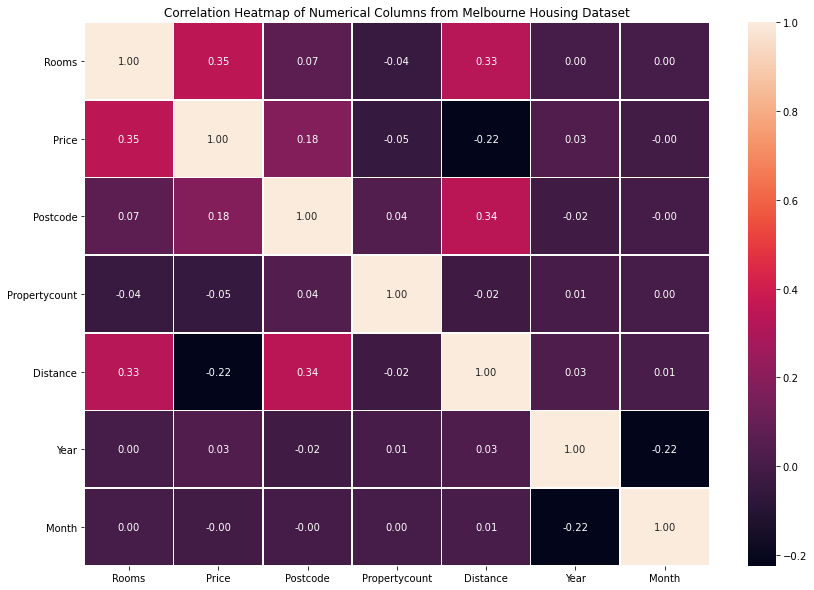

In [16]:
plt.figure(figsize=(14,10)) 
sns.heatmap(corr, annot=True, fmt='.2f', linewidths=.5,
           xticklabels=numerical_columns, yticklabels=numerical_columns)

plt.yticks(rotation = 0)
plt.title('Correlation Heatmap of Numerical Columns from Melbourne Housing Dataset')

The heatmap plot above indicates a slight negative correlation between Price and distance of the house from Melbourne CBD. Conversely, there is a positive relationship between price and the number of rooms that a house has.

To examine the two relationships further, a scatterplot has been produced below to visualize the relationship.

Text(0.5, 1.0, 'Scatterplot of Price and Distance from Melbourne CBD')

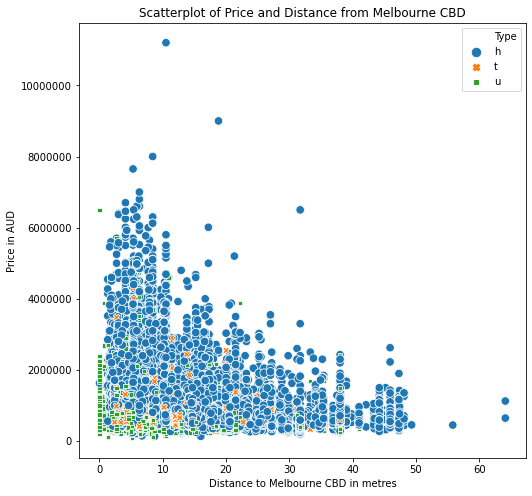

In [17]:
# Creating the canvass
fig = plt.figure(figsize = [8,8])

# Producing the scatterplot
sns.scatterplot(data = melb_df, x = 'Distance', y = 'Price', hue = 'Type', style = 'Type', size = 'Type')

# modifying several properties of the scatterplot
plt.ticklabel_format(style = 'Plain', axis = "y")
plt.ylabel('Price in AUD')
plt.xlabel('Distance to Melbourne CBD in metres')
plt.title('Scatterplot of Price and Distance from Melbourne CBD')

As expected, the further a house is situated from Melbourne CBD, the lower its price is. The scatterplot also confirms that the dataset is dominated by houses, with townhouses and unit duplexes occupying areas within or near to Melbourne CBD.

Finally, the graph below will show the linear modelling plot between price and distance to Melbourne CBD to emphasize their negative relationship.

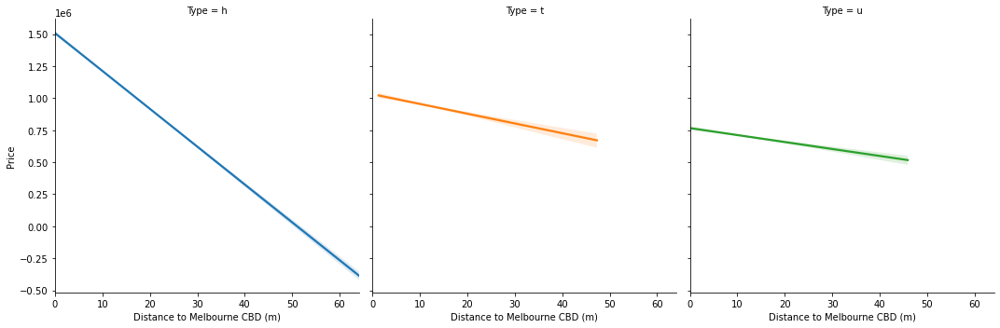

In [18]:
# creating a linear model plot
g = sns.lmplot(x="Distance", y="Price", col="Type", hue="Type", data=melb_df, height = 5, scatter = False)

# modifying the axis label
g.set_axis_labels("Distance to Melbourne CBD (m)", "Price")

# Section 4 - Summary

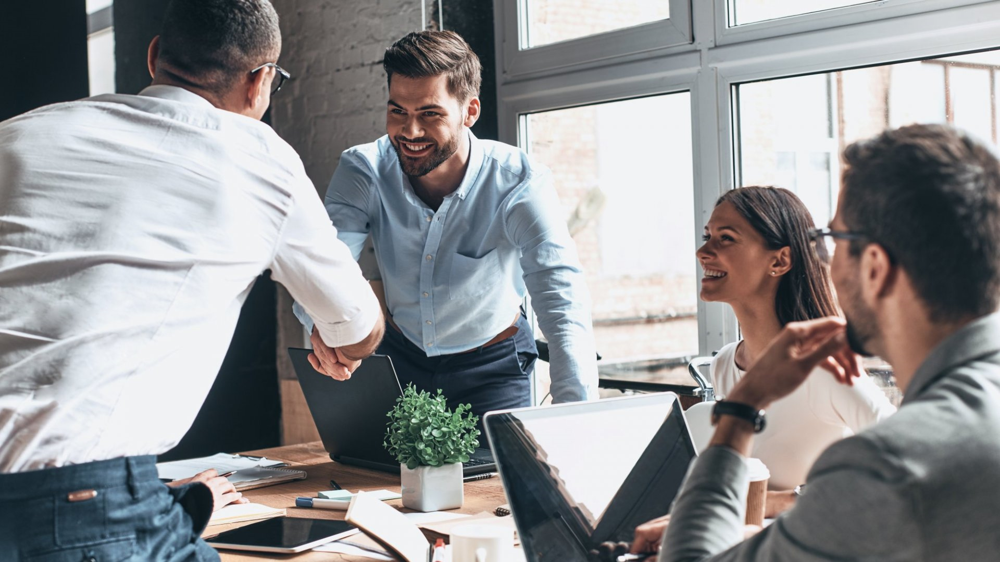

To conclude, the EDA has confirmed that housing prices downturn during 2018. However, the downturn had largely stabilized by the tail end of 2018, returning to mid-2018 price level. This strongly suggests that the market downturn is precipitated by cooling off from constant price rally from 2016 to 2017.

It has also revealed that ceteris paribus, houses with higher numbers of rooms will be more expensive, while houses located further from Melbourne CBD will be cheaper. 

It is recommended that the dataset be used further to ascertain the exact period when the downturn starts, as well as the basis for machine learning to forecast housing price in Melbourne for 2019.

# References

Katari, Kaushik 2020, 'Exploratory Data Analysis (EDA): Python', *Towards Data Science*, 22 August, viewed 05 October 2020 <https://towardsdatascience.com/exploratory-data-analysis-eda-python-87178e35b14> 

Moreno, A.I. 2020, 'Moving averages with Python', *Towards Data Science*, 8 July, viewed 05 October 2020 <br>
<https://towardsdatascience.com/moving-averages-in-python-16170e20f6c>

Pino, Tony 2018, *Melbourne Housing Market Dataset*, Melbourne, viewed 1 October 2020, <br><https://www.kaggle.com/anthonypino/melbourne-housing-market> 

Schlesinger, Larry 2017, 'Housing boom to roll on in 2017, end in 2018: Louis Christopher', *Australian Financial Review*, 4 January, viewed 08 October 2020, <https://www.afr.com/property/residential/housing-boom-to-roll-on-in-2017-end-in-2018-louis-christopher-20170103-gtl30e>

Zhou, Naaman 2019, 'Australian house prices falling at fastest rate in a decade', *The Guardian*, 2 January, viewed 8 October 2020, <https://www.theguardian.com/australia-news/2019/jan/02/australian-house-prices-falling-at-fastest-rate-in-a-decade-data-shows>

# Bibliography

Nelli, F. 2018, *Python Data Analytics*, $2^{nd}$ edn, Springer,  New York.

VanderPlas, Jake 2017, *Python Data Science Handbook*, O'Reilly Media, Sebastopol, CA.

# API Documentation Websites

- Matplotlib   : https://matplotlib.org/3.1.1/contents.html#
- Pandas       : https://pandas.pydata.org/docs/#
- Plotly       : https://plotly.com/python/
- Seaborn      : https://seaborn.pydata.org/api.html#